# Import pickled data and create dataframe

In [9]:
import os
import pickle
import pandas as pd
from collections import Counter

directory = '/Users/andersolson-swanson/Desktop/metis/metisgh/work/Luther/'


coach_list = []
team_list = []
opp_list = []
misc_list = []
opp_per100_list = []
per100_list = []
team_player_list = []

for filename in os.listdir(directory):
    if filename.endswith('.pkl'):
        if filename.startswith('overall_opp_p'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                opp_per100_list.append(my_old_data)
        if filename.startswith('overall_opp_d'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                opp_list.append(my_old_data)
        if filename.startswith('overall_team_d'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                team_list.append(my_old_data)
        if filename.startswith('overall_coa'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                coach_list.append(my_old_data)
        if filename.startswith('overall_team_pl'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                team_player_list.append(my_old_data)
        if filename.startswith('overall_pe'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                per100_list.append(my_old_data)
        if filename.startswith('overall_misc'):
            with open(filename, 'rb') as picklefile: 
                my_old_data = pickle.load(picklefile)
                misc_list.append(my_old_data)
    

coach_df_all = pd.concat(coach_list)
team_df_all = pd.concat(team_list)
opp_df_all = pd.concat(opp_list)
misc_df_all = pd.concat(misc_list)
opp_per100_df_all = pd.concat(opp_per100_list)
per100_df_all = pd.concat(per100_list)
team_player_df_all = pd.concat(team_player_list)




# remove duplicate rows in coach dataframe
coach_df_all = coach_df_all.drop_duplicates()
coach_df_all['year'] = coach_df_all['year'].str[:4].astype(int) + 1

cumsums = coach_df_all.groupby(['name', 'year']).sum().groupby(level=0).cumsum().reset_index()

cumsums = cumsums.drop(columns='age')

cumsums.columns = ['name', 'year', 'g_playoffs_cumul', 'games_cumul', \
                   'losses_cumul', 'losses_playoffs_cumul','wins_cumul', \
                   'wins_playoffs_cumul']

coach_df_all2 = pd.merge(coach_df_all, cumsums, on=['name','year'])
coach_df_all2 = coach_df_all2.rename(columns = {'name':'coach'})

coach_df_all2['team'].unique()

# update year so stats reflect prior season
#coach_df_all2['year'] = coach_df_all2['year'] + 1



team_df_all['Team'] = team_df_all['Team'].map(lambda x: x.replace('*', ''))
opp_df_all['Team'] = opp_df_all['Team'].map(lambda x: x.replace('*', ''))
misc_df_all['Team'] = misc_df_all['Team'].map(lambda x: x.replace('*', ''))
opp_per100_df_all['Team'] = opp_per100_df_all['Team'].map(lambda x: x.replace('*', ''))
per100_df_all['Team'] = per100_df_all['Team'].map(lambda x: x.replace('*', ''))
team_player_df_all['Team'] = team_player_df_all['Team'].map(lambda x: x.replace('*', ''))

team_age = misc_df_all[['age','Team','year']]

team_player_df_all = pd.merge(team_player_df_all, team_age, on=['Team','year'])


df4=pd.merge(team_player_df_all[['Team','year','players']],\
             team_player_df_all[['Team','players','year']],on='Team')

df4=df4[df4['year_x']-df4['year_y'] == 1]

def returning_players(row):
    results = Counter()
    for player in row['players_x']:
        results[player] = row['players_y'].count(player)
        
    return sum(results.values())

df4['returning_players'] = df4.apply(returning_players, axis=1)

df4 = df4.rename(columns = {'year_x':'year'})
df4 = df4.rename(columns = {'year_y':'year_2'})

team_player_df_all2 = pd.merge(team_player_df_all, df4, on=['Team','year'])


final_df = pd.merge(team_df_all, opp_df_all, on=['Team','year'])
final_df = pd.merge(final_df, misc_df_all, on=['Team','year'])
final_df = pd.merge(final_df, opp_per100_df_all, on=['Team','year'])
final_df = pd.merge(final_df, per100_df_all, on=['Team','year'])

final_df = final_df.drop(columns='age')




# update teams in coach table
team_dict = {'OKC':'Oklahoma City Thunder','WAS':'Washington Wizards',\
             'MIA':'Miami Heat','SAS':'San Antonio Spurs','CHI':'Chicago Bulls',\
             'LAC':'Los Angeles Clippers','CLE':'Cleveland Cavaliers', \
             'GSW':'Golden State Warriors', 'SEA':'Seattle SuperSonics',\
             'MIL':'Milwaukee Bucks', 'DEN':'Denver Nuggets', \
             'SAC':'Sacramento Kings', 'VAN':'Vancouver Grizzlies', \
             'MEM':'Memphis Grizzlies', 'BRK':'Brooklyn Nets', \
             'ATL':'Atlanta Hawks', 'NYK':'New York Knicks', \
             'MIN':'Minnesota Timberwolves','HOU':'Houston Rockets', \
             'IND':'Indiana Pacers', 'ORL':'Orlando Magic', \
             'LAL':'Los Angeles Lakers', 'DAL':'Dallas Mavericks', \
             'NJN':'New Jersey Nets', 'UTA':'Utah Jazz', 'DET':'Detroit Pistons',\
             'BOS':'Boston Celtics','PHO':'Phoenix Suns', \
             'POR':'Portland Trail Blazers', 'TOR':'Toronto Raptors', \
             'NOH':'New Orleans Hornets', 'NOP':'New Orleans Pelicans', \
             'PHI':'Philadelphia 76ers', 'NOK':'New Orleans/Oklahoma City Hornets',\
             'CHA':'Charlotte Bobcats', 'SDC':'San Diego Clippers',\
             'CHH':'Charlotte Hornets', 'WSB':'Washington Bullets', \
             'KCK':'Kansas City Kings', 'CHO':'Charlotte Hornets', \
             'NOJ':'New Orleans Jazz', 'CAR':'Carolina Cougars','DNA':'Denver Nuggets',\
             'KEN':'Kentucky Colonels','BUF':'Buffalo Braves','NYA':'New York Nets',\
             'KCO':'Kansas City King','DNR':'Denver Rockets','SAA':'San Antonio Spurs',\
             'UTS':'Utah Stars','SFW':'San Francisco Warrios','MLH':'Milwaukee Hawks',\
             'STL':'St Louis Hawks','CHZ':'Chicago Zyphers','INA':'Indiana Pacers',\
             'NYN':'New York Nets', 'SDA':'San Diego Conquistadors',\
             'CAP':'Capital Bullets', 'SDS':'San Diego Sails', 'VIR':'Virginia Squires',\
             'BAL':'Baltimore Bullets','DLC':'Dallas Chaparrals'}

coach_df_all2['Team'] = coach_df_all2['team'].apply(lambda x: team_dict[x])

# join coach table with player info table
coach_df_all2 = coach_df_all2.rename(columns = {'year':'year_2'})

team_player_df_all_withcoaches = pd.merge(team_player_df_all2, coach_df_all2, on=['year_2','coach'], how='left')
team_player_df_all_withcoaches = team_player_df_all_withcoaches.fillna(0)


# shift stats so they reflect previous year
final_df['year_2'] = final_df['year']
wins_by_team_by_year = final_df.groupby(['Team', 'year'])[['wins','Games']].sum().reset_index()
wins_by_team_by_year = wins_by_team_by_year.rename(columns = {'wins':'current_wins', 'Games':'current_games'})
final_df['year'] = final_df['year'] + 1
final_df = pd.merge(final_df, wins_by_team_by_year, on=['Team','year'])



# combine the last tables
team_player_df_all_withcoaches = team_player_df_all_withcoaches.rename(columns = {'Team_x':'Team'})
final_df = pd.merge(final_df, team_player_df_all_withcoaches, on=['year','Team'], how='left')





final_df = final_df.apply(pd.to_numeric, errors='ignore')

final_df['prev_win_pct'] = final_df['wins_x'] / final_df['Games']
final_df['current_win_pct'] = final_df['current_wins'] / final_df['current_games']



# Look at pair plots to pick features that I should focus on

In [12]:
columns = opp_per100_df_all.columns.tolist()
columns.append('current_win_pct')

new_df_opp_per100 = final_df[columns].dropna()

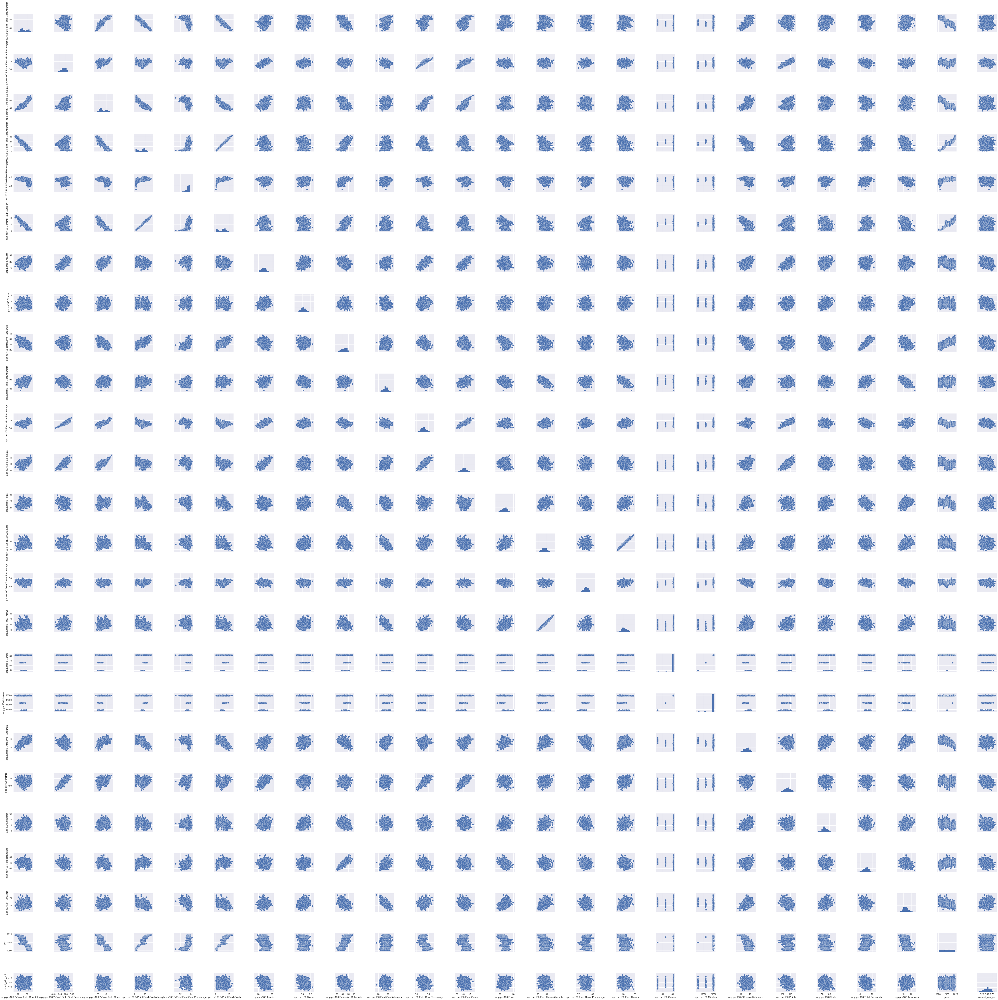

In [13]:
# look at pair plot for team columns

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

sns.pairplot(new_df_opp_per100)

columns that might be useful: 'opp per100 2-Point Field Goal Percentage', 'opp per100 3-Point Field Goal Percentage',
'opp per100 Assists', 'opp per100 Blocks', 'opp per100 Defensive Rebounds', 'opp per100 Field Goal Percentage',
'opp per100 Field Goals', 'opp per100 Points', 'opp per100 Steals', 'opp per100 Total Rebounds', 'opp per100 Turnovers'

In [14]:
columns = ['opp per100 2-Point Field Goal Percentage', 'opp per100 3-Point Field Goal Percentage', \
           'opp per100 Assists', 'opp per100 Blocks', 'opp per100 Defensive Rebounds', \
           'opp per100 Field Goal Percentage', 'opp per100 Field Goals', 'opp per100 Points', \
           'opp per100 Steals', 'opp per100 Total Rebounds', 'opp per100 Turnovers', 'current_win_pct']

new_df_opp_per100_2 = new_df_opp_per100[columns].dropna()

In [16]:
columns = misc_df_all.columns.tolist()
columns.remove('age')
columns.remove('losses')
columns.remove('wins')
columns.append('prev_win_pct')
columns.append('current_win_pct')
new_df_misc = final_df[columns].dropna()

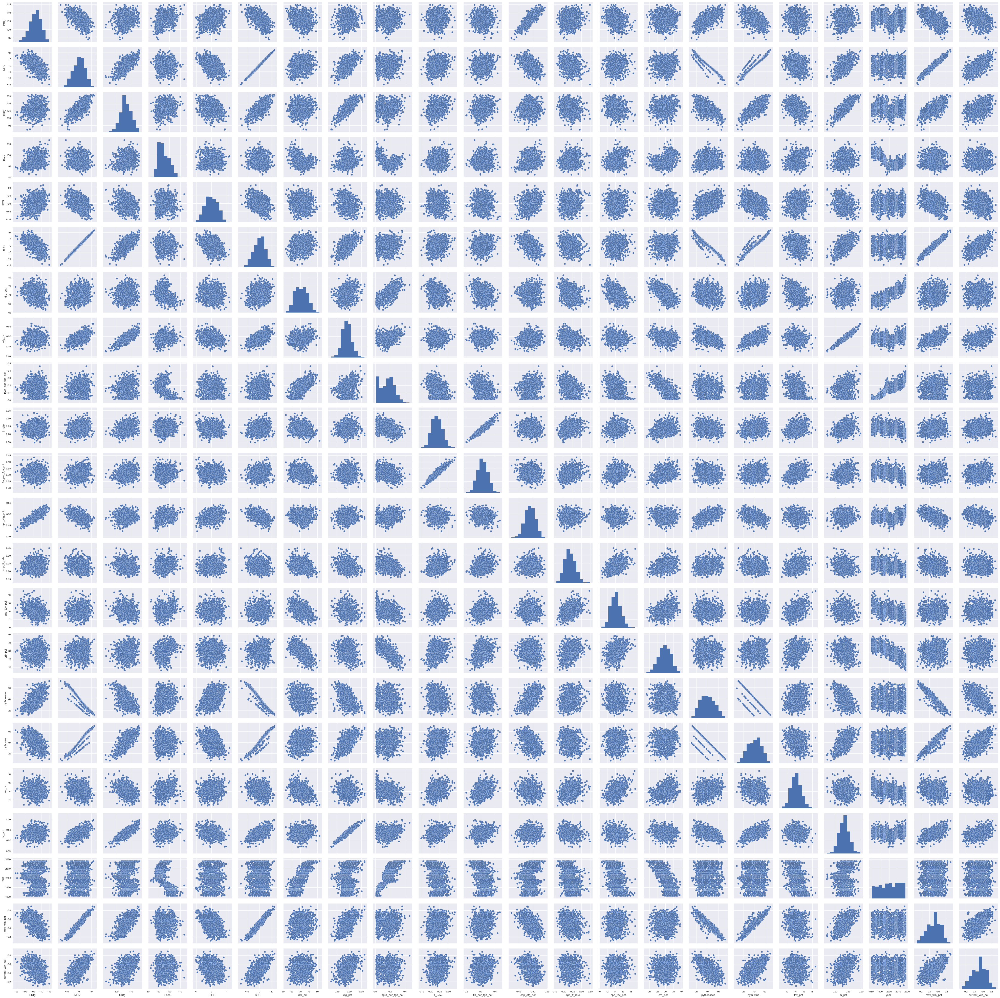

In [17]:
# look at pair plot for team columns

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

sns.pairplot(new_df_misc)

columns that might be useful: 'DRtg', 'MOV', 'ORtg','SOS', 'SRS', 'efg_pct', 'fta_per_fga_pct', 'opp_efg_pct', 
'tov_pct', 'ts_pct', 'prev_win_pct'

columns that are very colinear: efg_pct - ts_pct, SRS - MOV

In [18]:
columns = ['DRtg', 'MOV', 'ORtg','SOS', 'fta_per_fga_pct', 'opp_efg_pct', \
           'tov_pct', 'ts_pct', 'prev_win_pct', 'current_win_pct']

new_df_misc_2 = new_df_misc[columns].dropna()

In [20]:
columns = per100_df_all.columns.tolist()
columns.append('current_win_pct')
columns.remove('Team')
columns.remove('per100 Games')
columns.remove('year')
columns.remove('per100 Minutes')

new_df_per100 = final_df[columns].dropna()

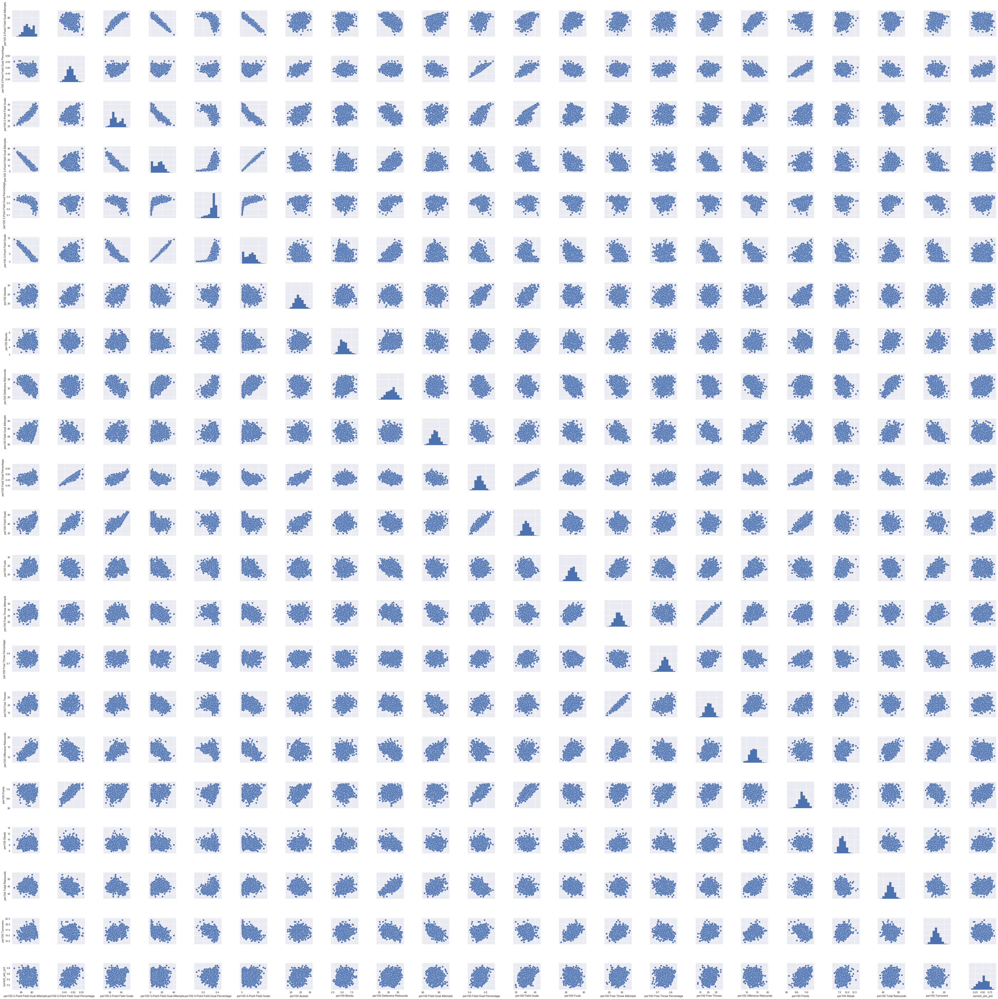

In [21]:
sns.pairplot(new_df_per100)

columns that might be useful: 'per100 2-Point Field Goal Percentage', 'per100 3-Point Field Goal Percentage',
'per100 Assists', 'per100 Blocks', 'per100 Defensive Rebounds', 'per100 Field Goal Percentage', 'per100 Field Goals',
'per100 Free Throw Percentage', 'per100 Points'

In [22]:
columns = ['per100 2-Point Field Goal Percentage', 'per100 3-Point Field Goal Percentage', \
           'per100 Assists', 'per100 Blocks', 'per100 Defensive Rebounds', 'per100 Field Goal Percentage', \
           'per100 Field Goals', 'per100 Free Throw Percentage', 'per100 Points', 'current_win_pct']

new_df_per100_2 = new_df_per100[columns].dropna()

In [24]:
columns = team_player_df_all2.columns.tolist()
columns.remove('age')
columns.append('age_x')
columns.append('current_win_pct')
columns.remove('Team')
columns.remove('coach')
columns.remove('players')
columns.remove('year')
columns.remove('year_2')

new_team_player_df_all = final_df[columns].dropna()

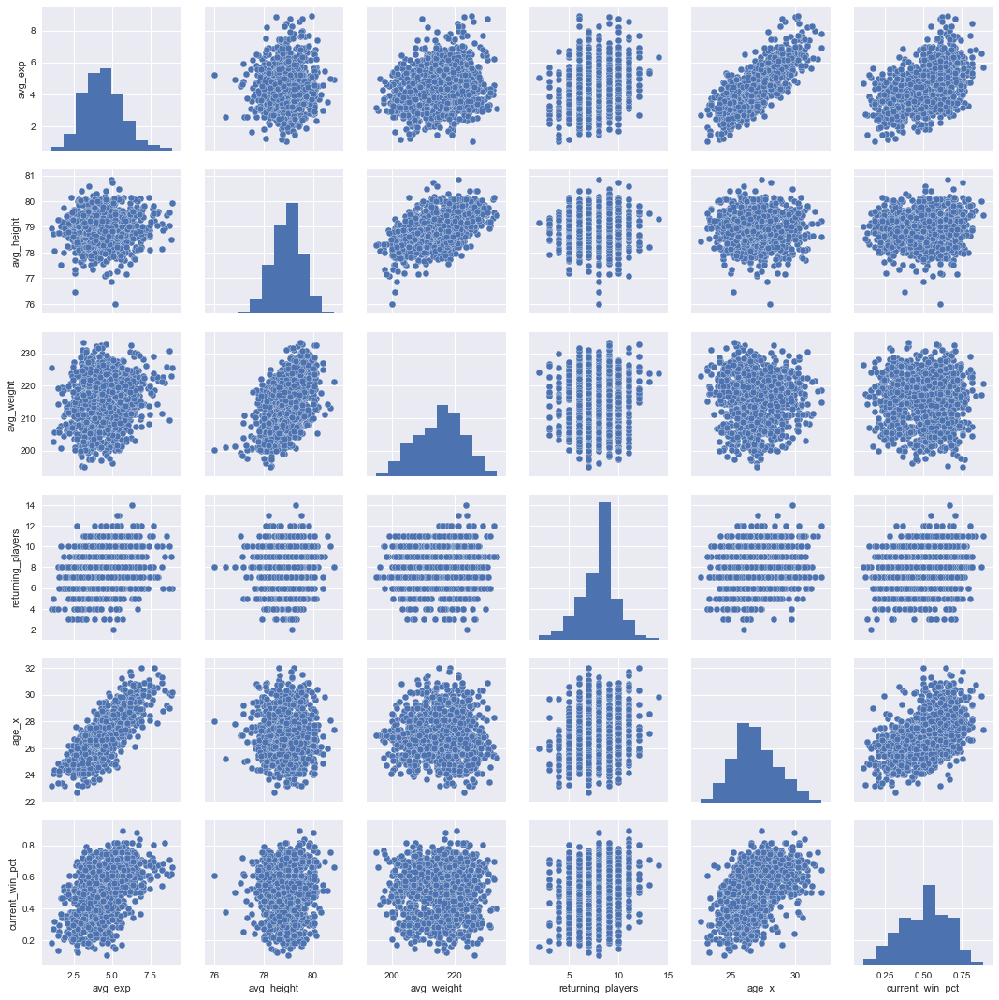

In [25]:
sns.pairplot(new_team_player_df_all)

columns that might be useful: 'avg_exp', 'returning_players', 'age_x'

In [26]:
columns = ['avg_exp', 'returning_players', 'age_x', 'current_win_pct']

new_team_player_df_all_2 = new_team_player_df_all[columns].dropna()

In [28]:
columns = coach_df_all2.columns.tolist()
#columns
columns.remove('age')
columns.append('age_y')
columns.append('current_win_pct')
columns.remove('Team')
columns.remove('coach')
columns.remove('dob')
columns.remove('coach_remarks')
columns.remove('league')
columns.remove('team')
columns.remove('year_2')
columns.remove('games')
columns.remove('g_playoffs')
columns.remove('wins')
columns.remove('losses')
columns.remove('losses_playoffs')
columns.remove('wins_playoffs')
columns.remove('rank_team')

new_coach_df_all = final_df[columns].dropna()

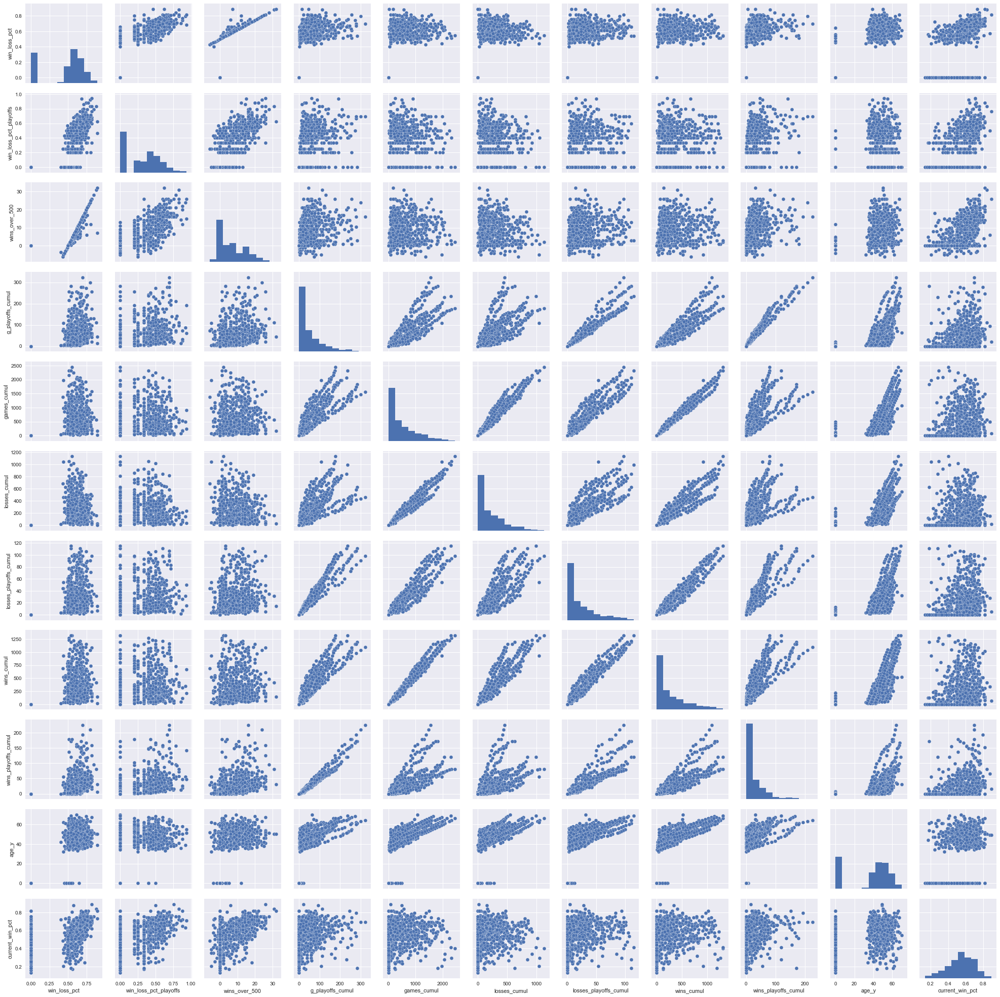

In [29]:
sns.pairplot(new_coach_df_all)

columns that might be useful: 'wins_cumul', 'wins_playoffs_cumul', 'games_cumul', 'losses_cumul', 'losses_playoffs_cumul', 'g_playoffs_cumul'

In [30]:
columns = ['wins_cumul', 'wins_playoffs_cumul', 'games_cumul', 'losses_cumul', 'losses_playoffs_cumul', \
           'g_playoffs_cumul', 'current_win_pct']

new_coach_df_all2 = new_coach_df_all[columns].dropna()

# Create new dataframe with features that I'm interested in

In [303]:
# I chose these features after looking at the pairplots and seeing a possible linear correlation 
# betweeen each feature and the target

In [32]:
column_list = []

column_list.append(new_coach_df_all2.columns.tolist())
column_list.append(new_team_player_df_all_2.columns.tolist())
column_list.append(new_df_misc_2.columns.tolist())
column_list.append(new_df_opp_per100_2.columns.tolist())
column_list.append(new_df_per100_2.columns.tolist())

In [33]:
column_list2 = set([item for sublist in column_list for item in sublist])

In [46]:
column_list3 = list(column_list2)
column_list3.remove('current_win_pct')
column_list3.append('year'),
column_list3.append('current_win_pct')

In [47]:
useful_features_df = final_df[column_list3].dropna()

In [38]:
useful_features_df.corr().iloc[-1].sort_values(ascending=False)

current_win_pct                             1.000000
MOV                                         0.681761
prev_win_pct                                0.667270
age_x                                       0.505765
ORtg                                        0.482499
per100 Points                               0.482499
avg_exp                                     0.470964
ts_pct                                      0.458537
per100 2-Point Field Goal Percentage        0.413475
per100 Field Goal Percentage                0.356290
per100 Assists                              0.339513
per100 Field Goals                          0.316776
wins_playoffs_cumul                         0.293409
g_playoffs_cumul                            0.279467
losses_playoffs_cumul                       0.245430
returning_players                           0.241026
per100 Defensive Rebounds                   0.234404
per100 Blocks                               0.212980
wins_cumul                                  0.

In [49]:
useful_df2 = useful_features_df[useful_features_df['year'] < 2018]
useful_df_2018 = useful_features_df[useful_features_df['year'] == 2018]

In [140]:
X_train = useful_df2.drop('current_win_pct', 1)
y_train = useful_df2['current_win_pct']
X_holdout = useful_df_2018.drop('current_win_pct', 1)
y_holdout = useful_df_2018['current_win_pct']

In [215]:
from sklearn.preprocessing import StandardScaler, PolynomialFeatures

scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_holdout_scaled = scaler.transform(X_holdout)

## Next step is to run some baseline models with different sets of features

# Test single feature, previous margin of victory

In [498]:
import statsmodels.api as sm
import statsmodels.formula.api as smf 

#baseline model with single feature & OLS regression summary stats
X_baseline_single=X_train['MOV']

y_baseline_single=y_train


model = sm.OLS(y_baseline_single,sm.add_constant(X_baseline_single))
results = model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        current_win_pct   R-squared:                       0.466
Model:                            OLS   Adj. R-squared:                  0.466
Method:                 Least Squares   F-statistic:                     876.0
Date:                Thu, 19 Jul 2018   Prob (F-statistic):          7.56e-139
Time:                        17:27:33   Log-Likelihood:                 769.07
No. Observations:                1004   AIC:                            -1534.
Df Residuals:                    1002   BIC:                            -1524.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5018      0.004    141.222      0.000       0.495       0.509
MOV            0.0227      0.001     29.598      0.000       0.021       0.024
==============================================================================
Omnibus:                       17.003   Durbin-Watson:                   2.050
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               18.868
Skew:                          -0.260   Prob(JB):                     8.00e-05
Kurtosis:                       3.425   Cond. No.                         4.64
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

# Test all features

In [216]:
import statsmodels.api as sm
import statsmodels.formula.api as smf 

#baseline model with all features & OLS regression summary stats
X_baseline=X_train_scaled

y_baseline=y_train




model = sm.OLS(y_baseline,sm.add_constant(X_baseline))
results = model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        current_win_pct   R-squared:                       0.511
Model:                            OLS   Adj. R-squared:                  0.493
Method:                 Least Squares   F-statistic:                     28.90
Date:                Wed, 18 Jul 2018   Prob (F-statistic):          2.07e-125
Time:                        16:06:37   Log-Likelihood:                 812.85
No. Observations:                1004   AIC:                            -1554.
Df Residuals:                     968   BIC:                            -1377.
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5027      0.003    145.242      0.000       0.496       0.509
x1             0.0473      0.030      1.588      0.113      -0.011       0.106
x2            -0.0009      0.007     -0.129      0.897      -0.014       0.013
x3             0.0024      0.019      0.123      0.902      -0.035       0.040
x4            -0.0166      0.022     -0.752      0.452      -0.060       0.027
x5            -0.0184      0.022     -0.839      0.402      -0.061       0.025
x6            -0.0779      0.053     -1.466      0.143      -0.182       0.026
x7            -0.0336      0.023     -1.440      0.150      -0.079       0.012
x8            -0.0050      0.006     -0.777      0.437      -0.018       0.008
x9             0.0202      0.007      3.068      0.002       0.007       0.033
x10            0.0032      0.004      0.799      0.424      -0.005       0.011
x11           -0.0038      0.007     -0.582      0.561      -0.017       0.009
x12            0.0069      0.008      0.884      0.377      -0.008       0.022
x13            0.0014      0.006      0.252      0.801      -0.009       0.012
x14           -0.0779      0.053     -1.466      0.143      -0.182       0.026
x15           -0.0112      0.116     -0.096      0.923      -0.239       0.217
x16           -0.0039      0.007     -0.562      0.574      -0.018       0.010
x17            0.0215      0.031      0.697      0.486      -0.039       0.082
x18            0.0281      0.094      0.300      0.764      -0.156       0.212
x19           -0.0013      0.005     -0.277      0.782      -0.011       0.008
x20           -0.0017      0.006     -0.276      0.783      -0.014       0.010
x21            0.2492      0.074      3.371      0.001       0.104       0.394
x22           -0.0566      0.043     -1.318      0.188      -0.141       0.028
x23            0.0473      0.030      1.588      0.113      -0.011       0.106
x24            0.0180      0.024      0.745      0.456      -0.029       0.065
x25            0.0052      0.009      0.577      0.564      -0.012       0.023
x26            0.0122      0.007      1.728      0.084      -0.002       0.026
x27           -0.0161      0.018     -0.893      0.372      -0.051       0.019
x28           -0.0047      0.036     -0.130      0.897      -0.075       0.066
x29            0.0303      0.031      0.994      0.320      -0.030       0.090
x30            0.0363      0.035      1.031      0.303      -0.033       0.105
x31           -0.0071      0.015     -0.465      0.642      -0.037       0.023
x32            0.0107      0.005      2.360      0.018       0.002       0.020
x33           -0.0137      0.020     -0.689      0.491      -0.053       0.025
x34           -0.0170      0.023     -0.744      0.457      -0.062       0.028
x35            0.0033      0.004      0.855      0.393      -0.004       0.011
x3

# Test removing several features

In [217]:
# I removed these features because they didn't appear to be adding anything to the model
# This is probably because they are very similar to other features and are thus redundant

import statsmodels.api as sm
import statsmodels.formula.api as smf 

#baseline model with certain features & OLS regression summary stats
X_minus_some=X_train.drop(['losses_playoffs_cumul', 'g_playoffs_cumul', 'year',\
                                   'games_cumul', 'losses_cumul', 'per100 2-Point Field Goal Percentage',\
                        'per100 3-Point Field Goal Percentage','per100 Free Throw Percentage',\
                         'opp per100 Field Goals','wins_cumul', 'per100 Field Goals',\
                         'opp per100 Field Goal Percentage', 'per100 Field Goal Percentage',\
                        'opp per100 Total Rebounds','opp per100 Defensive Rebounds'], 1)

y_baseline=y_train

scaler = StandardScaler()

X_minus_some_scaled = scaler.fit_transform(X_minus_some)


model = sm.OLS(y_baseline,sm.add_constant(X_minus_some_scaled))
results = model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        current_win_pct   R-squared:                       0.507
Model:                            OLS   Adj. R-squared:                  0.496
Method:                 Least Squares   F-statistic:                     45.85
Date:                Wed, 18 Jul 2018   Prob (F-statistic):          6.65e-134
Time:                        16:07:03   Log-Likelihood:                 808.68
No. Observations:                1004   AIC:                            -1571.
Df Residuals:                     981   BIC:                            -1458.
Df Model:                          22                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5027      0.003    145.607      0.000       0.496       0.509
x1             0.0464      0.026      1.773      0.077      -0.005       0.098
x2            -0.0196      0.011     -1.760      0.079      -0.041       0.002
x3            -0.0574      0.028     -2.040      0.042      -0.113      -0.002
x4            -0.0237      0.021     -1.148      0.251      -0.064       0.017
x5            -0.0062      0.005     -1.158      0.247      -0.017       0.004
x6             0.0214      0.006      3.378      0.001       0.009       0.034
x7             0.0034      0.004      0.857      0.392      -0.004       0.011
x8            -0.0055      0.006     -0.918      0.359      -0.017       0.006
x9             0.0046      0.007      0.641      0.522      -0.010       0.019
x10            0.0042      0.005      0.831      0.406      -0.006       0.014
x11           -0.0574      0.028     -2.040      0.042      -0.113      -0.002
x12           -0.0001      0.010     -0.014      0.989      -0.020       0.020
x13           -0.0017      0.005     -0.366      0.714      -0.011       0.007
x14            0.2459      0.072      3.414      0.001       0.105       0.387
x15            0.0464      0.026      1.773      0.077      -0.005       0.098
x16            0.0105      0.007      1.576      0.115      -0.003       0.024
x17           -0.0012      0.005     -0.236      0.813      -0.011       0.008
x18            0.0292      0.021      1.361      0.174      -0.013       0.071
x19           -0.0068      0.015     -0.450      0.653      -0.036       0.023
x20            0.0117      0.004      2.836      0.005       0.004       0.020
x21            0.0154      0.009      1.804      0.071      -0.001       0.032
x22           -0.0348      0.016     -2.235      0.026      -0.065      -0.004
x23            0.0038      0.004      1.016      0.310      -0.004       0.011
x24            0.0072      0.004      1.879      0.060      -0.000       0.015
==============================================================================
Omnibus:                       11.125   Durbin-Watson:                   2.054
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               11.915
Skew:                          -0.205   Prob(JB):                      0.00259
Kurtosis:                       3.342   Cond. No.                     2.65e+16
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.06e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

# Testing including specific features

In [304]:
# I chose these features using my prior knowledge of basketball. I thought these features would be the most useful.
# I was hoping that I could make the model simpler without sacrificing my R2

import statsmodels.api as sm
import statsmodels.formula.api as smf 

#baseline model with certain features & OLS regression summary stats
X_some=X_train[['DRtg', 'ORtg', 'avg_exp', 'wins_cumul', 'MOV', 'age_x','returning_players', 'wins_playoffs_cumul']]

y_baseline=y_train

scaler = StandardScaler()

X_some_scaled = scaler.fit_transform(X_some)


model = sm.OLS(y_baseline,sm.add_constant(X_some_scaled))
results = model.fit()

results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        current_win_pct   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.488
Method:                 Least Squares   F-statistic:                     120.7
Date:                Thu, 19 Jul 2018   Prob (F-statistic):          6.85e-141
Time:                        10:58:51   Log-Likelihood:                 794.23
No. Observations:                1004   AIC:                            -1570.
Df Residuals:                     995   BIC:                            -1526.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5027      0.003    144.548      0.000       0.496       0.510
x1             0.1247      0.050      2.494      0.013       0.027       0.223
x2            -0.1318      0.054     -2.435      0.015      -0.238      -0.026
x3             0.0135      0.006      2.377      0.018       0.002       0.025
x4            -0.0074      0.007     -1.134      0.257      -0.020       0.005
x5             0.2582      0.070      3.699      0.000       0.121       0.395
x6             0.0137      0.006      2.272      0.023       0.002       0.026
x7             0.0047      0.004      1.264      0.207      -0.003       0.012
x8             0.0141      0.007      2.069      0.039       0.001       0.028
==============================================================================
Omnibus:                       11.299   Durbin-Watson:                   2.037
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               11.910
Skew:                          -0.214   Prob(JB):                      0.00259
Kurtosis:                       3.318   Cond. No.                         54.1
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### Next step is to use cross validation to get a more meaningful R2

## Use cross validation on previous tests

**All features**

In [305]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
import numpy as np

reg = LinearRegression()
scores = cross_val_score(reg, X_train_scaled, y_train, cv=5, scoring='r2')

print('Using cv on all features gives an R2 of', np.mean(scores))

Using cv on all features gives an R2 of 0.4708534846006264


**Minus some features**

In [306]:
reg = LinearRegression()
scores = cross_val_score(reg, X_minus_some_scaled, y_train, cv=5, scoring='r2')

print('Using cv on most features gives an R2 of', np.mean(scores))

Using cv on most features gives an R2 of 0.480436641855776


**Only select features**

In [307]:
reg = LinearRegression()
scores = cross_val_score(reg, X_some_scaled, y_train, cv=5, scoring='r2')

print('Using cv on a select few features gives an R2 of', np.mean(scores))

Using cv on a select few features gives an R2 of 0.47944605329633055


The "minus some features" model performs the best in a simple cross validation

Below is a actual vs residual plot. I'm overpredicting when the win % is low and underpredicting when the win % is high

Text(0,0.5,'Residual')

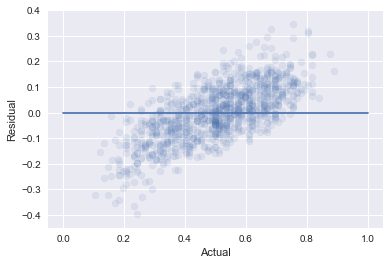

In [263]:
model = sm.OLS(y_baseline,sm.add_constant(X_minus_some_scaled))
results = model.fit()

y_pred = results.predict(sm.add_constant(X_minus_some_scaled))

plt.scatter(y_train,y_train-y_pred,alpha=.1)
plt.plot(np.linspace(0,1,1000),np.linspace(0,0,1000))
plt.xlabel('Actual')
plt.ylabel('Residual')

# Try adding polynomial terms

In [308]:
from sklearn.metrics import mean_squared_error

def add_square_terms(df):    
    
    df_poly = df.copy()
    
    for c in df.columns:
        df_poly[c + '**2'] = df[c]**2
        
    return df_poly



def RMSE(actual, predicted):
    return np.sqrt(mean_squared_error(actual,predicted)) 

In [425]:
X_minus_some_squared = add_square_terms(X_minus_some)

scaler = StandardScaler()

X_minus_some_squared_scaled = scaler.fit_transform(X_minus_some_squared)

reg = LinearRegression()
scores = cross_val_score(reg, X_minus_some_squared_scaled, y_train, cv=5, scoring='r2')

print('Using cv on most features squared gives an R2 of', np.mean(scores))

Using cv on most features squared gives an R2 of 0.4660312922181548


**Adding squared terms doesn't improve the R-squared of the model**

### The "minus some features" model has performed the best so far. The unsquared vs squared version seem pretty similar
### I will try some regularization to see if that can improve the models

# Using Lasso and Ridge

### Taking "minus some features" model and running it through different CV methods

In [496]:
from sklearn.linear_model import RidgeCV, LassoCV, ElasticNetCV, Lasso, Ridge, ElasticNet

lcv_l = LassoCV(cv=5)  #shift-tab here 

lcv_l.fit(X_minus_some_scaled, y_train)

reg = Lasso(alpha=lcv_l.alpha_)
scores = cross_val_score(reg, X_minus_some_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

Lasso r2 is 0.4842838344225705


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [230]:
lcv_r = RidgeCV(cv=5)  #shift-tab here 

lcv_r.fit(X_minus_some_scaled, y_train)

reg = Ridge(alpha=lcv_r.alpha_)
scores = cross_val_score(reg, X_minus_some_scaled, y_train, cv=5, scoring='r2')
print('Ridge r2 is', np.mean(scores))

Ridge r2 is 0.48344131653397626


# Using Lasso and Ridge on Squared

### Taking "minus some features plus squared terms" model and running it through different CV methods

In [232]:
lcv_l2 = LassoCV(cv=5)  #shift-tab here 

lcv_l2.fit(X_minus_some_squared_scaled, y_train)

reg = Lasso(alpha=lcv_l2.alpha_)
scores = cross_val_score(reg, X_minus_some_squared_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

Lasso r2 is 0.48473594256927965


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


In [233]:
lcv_r2 = RidgeCV(cv=5)  #shift-tab here 

lcv_r2.fit(X_minus_some_squared_scaled, y_train)

reg = Ridge(alpha=lcv_r2.alpha_)
scores = cross_val_score(reg, X_minus_some_squared_scaled, y_train, cv=5, scoring='r2')
print('Ridge r2 is', np.mean(scores))

Ridge r2 is 0.4801090518541691


**LassoCV on the polynomial model gives highest result**

# See if any features get removed by Lasso

In [517]:
list(zip(X_minus_some.columns,lcv_l.coef_))

[('DRtg', 0.0),
 ('opp per100 Turnovers', 0.0),
 ('per100 Points', 0.007007394053338259),
 ('opp per100 2-Point Field Goal Percentage', 0.0),
 ('opp per100 Assists', 0.08402391960166812),
 ('avg_exp', 0.010387455404830714),
 ('SOS', 0.0),
 ('opp per100 Steals', 0.02376972499894667),
 ('opp per100 3-Point Field Goal Percentage', 0.0),
 ('per100 Assists', 0.0028176403948729314),
 ('ORtg', 0.00780081241982102),
 ('ts_pct', -0.011003058192751316),
 ('opp per100 Blocks', 0.0037789807197981798),
 ('MOV', 0.0),
 ('opp per100 Points', 0.004777127573405729),
 ('age_x', -0.009041102632659245)]

### Looks like some of the features aren't as important as some of the others (because the coefficients are 0)

In [244]:
# Pick features that have a coefficient other than 0.0

X_testing = X_minus_some[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', 'ts_pct',\
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                                 'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul']]

scaler = StandardScaler()

X_testing_scaled = scaler.fit_transform(X_testing)

reg = LinearRegression()
scores = cross_val_score(reg, X_testing_scaled, y_train, cv=5, scoring='r2')

print('Using cv on test gives an R2 of', np.mean(scores))

Using cv on test gives an R2 of 0.4865386700673895


In [245]:
lcv_l_test = LassoCV(cv=5)  #shift-tab here 

lcv_l_test.fit(X_testing_scaled, y_train)

reg = Lasso(alpha=lcv_l_test.alpha_)
scores = cross_val_score(reg, X_testing_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

Lasso r2 is 0.4872240990684512


### Both normal cv and Lasso cv give a higher R-squared than before

### Are any of the features not useful?

In [248]:
list(zip(X_testing.columns,lcv_l_test.coef_))

[('per100 Points', 0.004859752737619057),
 ('opp per100 Assists', -0.003445168532322493),
 ('avg_exp', 0.02118781241741382),
 ('opp per100 Steals', -0.006037556092109955),
 ('opp per100 3-Point Field Goal Percentage', 0.005732819117588172),
 ('per100 Assists', 0.0052515990261209206),
 ('ORtg', 0.0014873783629602835),
 ('ts_pct', 0.0),
 ('MOV', 0.07958652249534548),
 ('opp per100 Blocks', -0.001760945021575905),
 ('age_x', 0.00828652184777009),
 ('per100 Blocks', 0.011488277773404854),
 ('tov_pct', 0.014865159674122054),
 ('per100 Defensive Rebounds', -0.007986875670661909),
 ('returning_players', 0.0035420435611486847),
 ('wins_playoffs_cumul', 0.0067425003575163475)]

### Again, one of the features is not as important as the others (because the coefficient is 0)

# Removing more features

In [313]:
# Pick features that have a coefficient other than 0.0

X_testing2 = X_minus_some[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', \
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                                 'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul']]

scaler = StandardScaler()

X_testing2_scaled = scaler.fit_transform(X_testing2)

reg = LinearRegression()
scores = cross_val_score(reg, X_testing2_scaled, y_train, cv=5, scoring='r2')

print('Using cv on test2 gives an R2 of', np.mean(scores))

Using cv on test2 gives an R2 of 0.48747104118497564


In [253]:
lcv_l_test2 = LassoCV(cv=5)  #shift-tab here 

lcv_l_test2.fit(X_testing2_scaled, y_train)

reg = Lasso(alpha=lcv_l_test2.alpha_)
scores = cross_val_score(reg, X_testing2_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

Lasso r2 is 0.48762288452893954


### Again, removing some features improves the normal cv and Lasso cv R-squared

#### Check the lasso coefficients again to see if any are 0 (they aren't)

In [257]:
list(zip(X_testing2.columns,lcv_l_test2.coef_))

[('per100 Points', 0.0049268593366792535),
 ('opp per100 Assists', -0.003372978012303726),
 ('avg_exp', 0.021150705735565642),
 ('opp per100 Steals', -0.0058186908791440384),
 ('opp per100 3-Point Field Goal Percentage', 0.005522018615612686),
 ('per100 Assists', 0.005201802466817735),
 ('ORtg', 0.001459414152370134),
 ('MOV', 0.0795503352487829),
 ('opp per100 Blocks', -0.0017067889523554433),
 ('age_x', 0.008275288373177809),
 ('per100 Blocks', 0.01140936422721765),
 ('tov_pct', 0.014646842572835729),
 ('per100 Defensive Rebounds', -0.007764881800646666),
 ('returning_players', 0.003515573538148306),
 ('wins_playoffs_cumul', 0.006714371578188391)]

Plotting the actual vs residual values again gives me a very similar plot. I'm overpredicting when the win % is low and underpredicting when the win % is high

Text(0,0.5,'Residual')

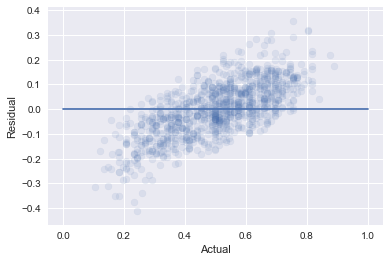

In [262]:
pred = lcv_r_test2.predict(X_testing2_scaled)

plt.scatter(y_train, y_train-pred,alpha=.1)
plt.plot(np.linspace(0,1,1000),np.linspace(0,0,1000))
plt.xlabel('Actual')
plt.ylabel('Residual')

# Adding polynomial terms for single features at a time

Squaring all of the features didn't improve my model but maybe squaring a single feature at a time will improve it.

In [314]:

for i in range(len(X_testing2.columns)):
    X_2 = X_testing2.copy()
    c = X_testing2.columns[i]
    X_2[c + '**2'] = X_testing2[c]**2
    
    scaler = StandardScaler()

    X_2_scaled = scaler.fit_transform(X_2)
    
    lasso_cv = LassoCV(cv=5)
    lasso_cv.fit(X_2_scaled, y_train)
    
    reg = Lasso(alpha=lasso_cv.alpha_)
    scores = cross_val_score(reg, X_2_scaled, y_train, cv=5, scoring='r2')
    print(c, 'Lasso r2 is', np.mean(scores))
    
    

/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


per100 Points Lasso r2 is 0.48775401763060716
opp per100 Assists Lasso r2 is 0.4876195039219734
avg_exp Lasso r2 is 0.48755415802648694
opp per100 Steals Lasso r2 is 0.487780818416527
opp per100 3-Point Field Goal Percentage Lasso r2 is 0.4876588546242912
per100 Assists Lasso r2 is 0.4878312633387331
ORtg Lasso r2 is 0.48775401763060716
MOV Lasso r2 is 0.48838993982104706


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


opp per100 Blocks Lasso r2 is 0.4877242449203149
age_x Lasso r2 is 0.4876223318121761
per100 Blocks Lasso r2 is 0.48762289529238967
tov_pct Lasso r2 is 0.4876228897276736
per100 Defensive Rebounds Lasso r2 is 0.4874190784875118
returning_players Lasso r2 is 0.48776053277018167
wins_playoffs_cumul Lasso r2 is 0.48668923539815456


squaring only MOV slightly improves the R-squared

Let's see if cubing a single feature at a time will improve the model

In [315]:
for i in range(len(X_testing2.columns)):
    X_2 = X_testing2.copy()
    c = X_testing2.columns[i]
    X_2[c + '**3'] = X_testing2[c]**3
    
    scaler = StandardScaler()

    X_2_scaled = scaler.fit_transform(X_2)
    
    lasso_cv = LassoCV(cv=5)
    lasso_cv.fit(X_2_scaled, y_train)
    
    reg = Lasso(alpha=lasso_cv.alpha_)
    scores = cross_val_score(reg, X_2_scaled, y_train, cv=5, scoring='r2')
    print(c, 'Lasso r2 is', np.mean(scores))

/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


per100 Points Lasso r2 is 0.48788240097119073
opp per100 Assists Lasso r2 is 0.48760077625420556
avg_exp Lasso r2 is 0.48743855278358106
opp per100 Steals Lasso r2 is 0.48788364692958297
opp per100 3-Point Field Goal Percentage Lasso r2 is 0.48770052262175173
per100 Assists Lasso r2 is 0.4880226294489204
ORtg Lasso r2 is 0.48788240097119073
MOV Lasso r2 is 0.4876099294091792
opp per100 Blocks Lasso r2 is 0.4877664833560951


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


age_x Lasso r2 is 0.4881992599961015
per100 Blocks Lasso r2 is 0.4876202967307247
tov_pct Lasso r2 is 0.4876227321514833
per100 Defensive Rebounds Lasso r2 is 0.4872195290122286
returning_players Lasso r2 is 0.4874902541495249
wins_playoffs_cumul Lasso r2 is 0.486425009822125


cubing age only or cubing assists only slightly increases R2

# Combining above polynomials

Try adding the 3 polynomial terms that we created above to see if a combination of them improves the model

In [294]:
X_testing3 = X_minus_some[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', \
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                                 'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul']]

X_testing3['MOV**2'] = X_testing3['MOV']**2
X_testing3['age_x**3'] = X_testing3['age_x']**3
X_testing3['per100 Assists**3'] = X_testing3['per100 Assists']**3

scaler = StandardScaler()

X_testing3_scaled = scaler.fit_transform(X_testing3)

lasso_cv = LassoCV(cv=5)
lasso_cv.fit(X_testing3_scaled, y_train)

reg = Lasso(alpha=lasso_cv.alpha_)
scores = cross_val_score(reg, X_testing3_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

Lasso r2 is 0.48964645877730106


# This is the final model chosen (below)

In [465]:
X_testing3 = X_minus_some[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', \
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                                 'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul']]

X_testing3['MOV**2'] = X_testing3['MOV']**2
X_testing3['age_x**3'] = X_testing3['age_x']**3
#X_testing3['per100 Assists**3'] = X_testing3['per100 Assists']**3

scaler = StandardScaler()

X_testing3_scaled = scaler.fit_transform(X_testing3)

lasso_cv = LassoCV(cv=5)
lasso_cv.fit(X_testing3_scaled, y_train)

reg = Lasso(alpha=lasso_cv.alpha_)
scores = cross_val_score(reg, X_testing3_scaled, y_train, cv=5, scoring='r2')
print('Lasso r2 is', np.mean(scores))

Lasso r2 is 0.48964967360144784


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


Adding the squared Margin of victory and the cubed player age slightly increases the R-squared and gives a barely higher R-squared than adding all 3 polynomials.

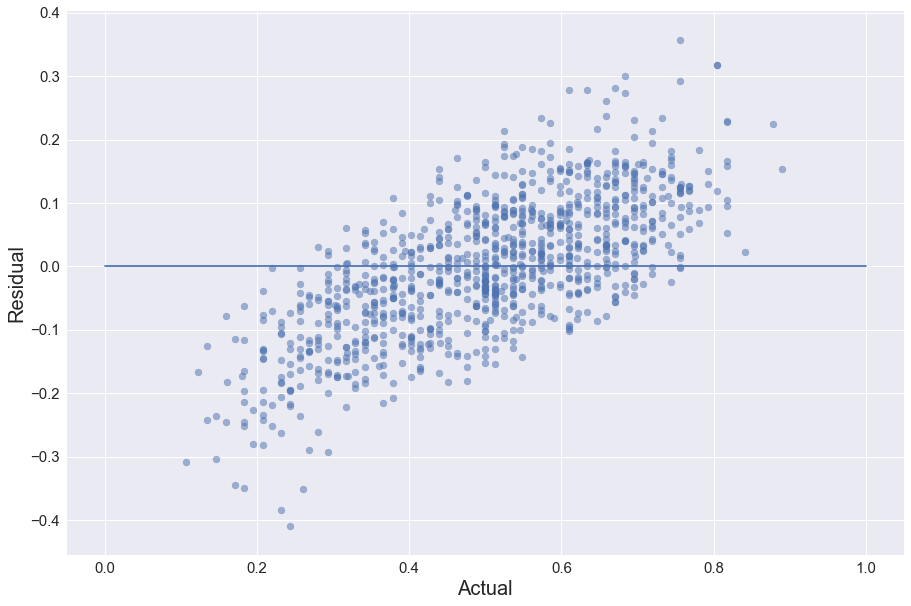

In [562]:
from pylab import rcParams

pred = lasso_cv.predict(X_testing3_scaled)

rcParams['figure.figsize'] = 15, 10
SMALL_SIZE = 15
MEDIUM_SIZE = 20
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)

plt.scatter(y_train, y_train-pred,alpha=.5)
plt.plot(np.linspace(0,1,1000),np.linspace(0,0,1000))
plt.xlabel('Actual')
plt.ylabel('Residual')



plt.savefig('Luther_residual.png', bbox_inches='tight')

In [532]:
list(zip(X_testing3.columns,lasso_cv.coef_))

[('per100 Points', 0.006201630838825953),
 ('opp per100 Assists', -0.004562544115831249),
 ('avg_exp', 0.021481699471797865),
 ('opp per100 Steals', -0.007359304218988849),
 ('opp per100 3-Point Field Goal Percentage', 0.006243373029985803),
 ('per100 Assists', 0.005398121140283741),
 ('ORtg', 0.00029915058882853577),
 ('MOV', 0.07966535605739036),
 ('opp per100 Blocks', -0.001931204080407901),
 ('age_x', 0.05879367364919879),
 ('per100 Blocks', 0.011315085780627709),
 ('tov_pct', 0.01621985425682663),
 ('per100 Defensive Rebounds', -0.008356438785484473),
 ('returning_players', 0.003392862771755118),
 ('wins_playoffs_cumul', 0.006658771848656468),
 ('MOV**2', 0.005303224878267086),
 ('age_x**3', -0.05059585030006931)]

All features seem to be useful since all coefficients are non-zero

### We have a final model! (hopefully)

## Looking at wrong predictions

In [451]:
pred1 = pd.DataFrame(pred)

pred1 = pred1.rename({0: 'pred'}, axis='columns')

outlier_inv = final_df[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', \
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                            'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul',\
                      'Team', 'prev_win_pct', 'current_win_pct','year']]

outlier_inv = outlier_inv.dropna()
outlier_inv = outlier_inv[outlier_inv['year'] < 2018].reset_index()
outlier_inv = outlier_inv[['Team', 'prev_win_pct', 'current_win_pct','year']]
outlier_inv = outlier_inv.join(pred1)

outlier_inv['diff'] = outlier_inv['current_win_pct'] - outlier_inv['pred']

In [460]:
outlier_inv.sort_values(by='diff', ascending=False).head(4)

,Team,prev_win_pct,current_win_pct,year,pred,diff
837,Phoenix Suns,0.353659,0.756098,2005,0.399125,0.356972
760,Boston Celtics,0.292683,0.804878,2008,0.487244,0.317634
732,Cleveland Cavaliers,0.548780,0.804878,2009,0.487811,0.317067
523,San Antonio Spurs,0.256098,0.682927,1990,0.382880,0.300047


The above table shows teams where my model underpredicted. After some research, I found that 3 of the 4 teams added their top players in between the seasons, hence the big jump in wins.

In [458]:
outlier_inv.sort_values(by='diff').head(5)

,Team,prev_win_pct,current_win_pct,year,pred,diff
318,San Antonio Spurs,0.719512,0.243902,1997,0.652992,-0.409090
952,Cleveland Cavaliers,0.743902,0.231707,2011,0.615125,-0.383418
264,Chicago Bulls,0.756098,0.260000,1999,0.610039,-0.350039
765,Miami Heat,0.536585,0.182927,2008,0.532090,-0.349163
570,Houston Rockets,0.560976,0.170732,1983,0.514739,-0.344007


The above table shows teams where my model overpredicted. After some research, I found that 3 of these teams lost their top player in the offseason and the other 2 saw their top player injured during the season.

If I could incorporate injuries and movement of top players, I think my model would improve.

# Taking this model and applying it to the holdout data we created in the beginning

In [487]:
from sklearn.metrics import mean_squared_error

X_model = X_holdout[['per100 Points', 'opp per100 Assists', 'avg_exp', 'opp per100 Steals',\
                          'opp per100 3-Point Field Goal Percentage', 'per100 Assists', 'ORtg', \
                          'MOV', 'opp per100 Blocks', 'age_x', 'per100 Blocks', 'tov_pct', \
                                 'per100 Defensive Rebounds', 'returning_players', 'wins_playoffs_cumul']]


X_model['MOV**2'] = X_model['MOV']**2
X_model['age_x**3'] = X_model['age_x']**3

#scaler = StandardScaler()

X_model_scaled = scaler.transform(X_model)

#reg.fit(X_testing3_scaled, y_train)
print('R squared is', lasso_cv.score(X_model_scaled, y_holdout))

y_pred = lasso_cv.predict(X_model_scaled)

print('RMSE is', np.sqrt(mean_squared_error(y_pred, y_holdout)))

R squared is 0.4077791133614804
RMSE is 0.11277468022342016


/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/andersolson-swanson/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys


In [488]:
# Convert the RMSE of % to actual games

0.11277468022342016 * 82

9.247523778320453

#### Create initial table to be used in conjuction with gambling data

In [471]:
pred = pd.DataFrame(y_pred)

pred = pred.rename({0: 'pred'}, axis='columns')

all_rows_cols = final_df[['Team', 'prev_win_pct', 'current_win_pct','year']]

gambling_table = all_rows_cols[all_rows_cols['year'] == 2018].reset_index()

gambling_table = gambling_table.join(pred)

# Importing gambling data

In [295]:
import requests

url = 'http://www.vegasinsider.com/nba/story.cfm/story/1865923'

response = requests.get(url)

In [296]:
from bs4 import BeautifulSoup

page = response.text
soup = BeautifulSoup(page, "lxml")

In [299]:
teams = soup.find_all('span')[20:50]

team_list = []

for i in range(len(teams)):
    team_list.append(teams[i].text)

In [300]:
s = soup.find('span', text='Atlanta Hawks').parent.text[1900:]

In [301]:
import re

prog = re.compile(r'Over [0-9][0-9] .|Over [0-9][0-9]')
result = prog.findall(s)

bet_list = []
for bet in result:
    bet = bet.replace('Over ', '').replace(' ½', '.5')
    bet = float(bet)
    bet_list.append(bet)

team_bets = dict(zip(team_list, bet_list))

In [472]:
gambling_table['overunder']= gambling_table['Team'].map(team_bets)

In [473]:
gambling_table['pred_wins'] = gambling_table['pred']*82
gambling_table['diff_pred'] = gambling_table['pred_wins'] - gambling_table['overunder']
gambling_table['bet'] = gambling_table['diff_pred'].apply(lambda x: 1 if x > 0 else 0)
gambling_table['actual_wins'] = gambling_table['current_win_pct']*82
gambling_table['diff_actual'] = gambling_table['actual_wins'] - gambling_table['overunder']
gambling_table['winning_bet'] = gambling_table['diff_actual'].apply(lambda x: 1 if x > 0 else 0)
gambling_table['good_bet'] = gambling_table['winning_bet'] - gambling_table['bet']

gambling_table['good_bet'] = gambling_table['good_bet'].apply(lambda x: 1 if x == 0 else 0)

In [490]:
gambling_table.sort_values(by='prev_win_pct')

,index,Team,prev_win_pct,current_win_pct,year,pred,overunder,pred_wins,diff_pred,bet,actual_wins,diff_actual,winning_bet,good_bet,abs_diff_pred
11,653,Brooklyn Nets,0.243902,0.341463,2018,0.332953,26.5,27.302110,0.802110,1,28.0,1.5,1,1,0.802110
8,650,Phoenix Suns,0.292683,0.256098,2018,0.343143,28.5,28.137719,-0.362281,0,21.0,-7.5,0,1,0.362281
16,658,Los Angeles Lakers,0.317073,0.426829,2018,0.309301,32.5,25.362654,-7.137346,0,35.0,2.5,1,0,7.137346
24,666,Philadelphia 76ers,0.341463,0.634146,2018,0.392190,40.5,32.159603,-8.340397,0,52.0,11.5,1,0,8.340397
26,668,Orlando Magic,0.353659,0.304878,2018,0.336052,30.5,27.556226,-2.943774,0,25.0,-5.5,0,1,2.943774
12,654,Minnesota Timberwolves,0.378049,0.573171,2018,0.484488,46.5,39.728030,-6.771970,0,47.0,0.5,1,0,6.771970
18,660,New York Knicks,0.378049,0.353659,2018,0.412730,30.5,33.843851,3.343851,1,29.0,-1.5,0,0,3.343851
23,665,Sacramento Kings,0.390244,0.329268,2018,0.389810,29.0,31.964461,2.964461,1,27.0,-2.0,0,0,2.964461
29,671,Dallas Mavericks,0.402439,0.292683,2018,0.422084,35.5,34.610928,-0.889072,0,24.0,-11.5,0,1,0.889072
17,659,New Orleans Pelicans,0.414634,0.585366,2018,0.448010,40.5,36.736828,-3.763172,0,48.0,7.5,1,0,3.763172


In [475]:
gambling_table['good_bet'].mean()

0.5

Using model to bet on all teams, I would have won 50% of the time. This is the same as random guessing :(

In [476]:
gambling_table['abs_diff_pred'] = gambling_table['diff_pred'].abs()

In [483]:
bottom8_diff = gambling_table.sort_values(by='abs_diff_pred').head(8)

In [484]:
bottom8_diff['good_bet'].mean()

0.875

If I just look at the smallest differences between the model prediction and the over/under wins, the performance improves. Using the top 8, I would have won 87.5% of the time. This seems like just chance since the differences between the model's predictions and the over/unders are so small.